In [76]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
from sklearn.decomposition import PCA
import itertools


In [2]:
df = pd.read_csv("Diabetes_Prediction_2018_2022.csv")
df.head()

,Diabetes_012,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
0,0,0,1,0,40,1,0,0,0,0,...,0,1,0,5,18,15,1,0,9,4
1,0,0,0,0,25,1,0,0,1,0,...,0,0,1,3,0,0,0,0,7,6
2,0,1,1,1,28,0,0,0,0,1,...,0,1,1,5,30,30,1,0,9,4
3,0,1,0,1,27,0,0,0,1,1,...,0,1,0,2,0,0,0,0,11,3
4,0,1,1,1,24,0,0,0,1,1,...,0,1,0,2,3,0,0,0,11,5


In [3]:
df.describe()

,Diabetes_012,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
count,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,...,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000,249998.000000
mean,0.294538,0.427631,0.423815,0.962368,28.385631,0.445396,0.040800,0.093909,0.759714,0.636049,...,0.056484,0.951036,0.083489,2.503672,3.171241,4.222078,0.167269,0.441368,8.041152,5.056192
std,0.695924,0.494736,0.494163,0.190306,6.620666,0.497010,0.197828,0.291702,0.427258,0.481136,...,0.230855,0.215794,0.276620,1.065986,7.382264,8.694342,0.373217,0.496551,3.049967,0.979742
min,0.000000,0.000000,0.000000,0.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,1.000000,24.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,6.000000,4.000000
50%,0.000000,0.000000,0.000000,1.000000,27.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,8.000000,5.000000
75%,0.000000,1.000000,1.000000,1.000000,31.000000,1.000000,0.000000,0.000000,1.000000,1.000000,...,0.000000,1.000000,0.000000,3.000000,2.000000,3.000000,0.000000,1.000000,10.000000,6.000000
max,2.000000,1.000000,1.000000,1.000000,98.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,5.000000,30.000000,30.000000,1.000000,1.000000,13.000000,6.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 249998 entries, 0 to 249997
Data columns (total 21 columns):
 #   Column                Non-Null Count   Dtype
---  ------                --------------   -----
 0   Diabetes_012          249998 non-null  int64
 1   HighBP                249998 non-null  int64
 2   HighChol              249998 non-null  int64
 3   CholCheck             249998 non-null  int64
 4   BMI                   249998 non-null  int64
 5   Smoke                 249998 non-null  int64
 6   Stroke                249998 non-null  int64
 7   HeartDiseaseorAttack  249998 non-null  int64
 8   PhysicalActivity      249998 non-null  int64
 9   Fruits                249998 non-null  int64
 10  Veggies               249998 non-null  int64
 11  AlcoholConsump        249998 non-null  int64
 12  AnyHealthcare         249998 non-null  int64
 13  NoDocbcCost           249998 non-null  int64
 14  GenHlth               249998 non-null  int64
 15  MentHlth              249998 non-n

In [5]:
df.shape

(249998, 21)

# Variable Analysis

In [6]:
diabetes_column = df['Diabetes_012']
df_scaled = df.drop(columns=['Diabetes_012'])

scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(df_scaled)

df_scaled = pd.DataFrame(scaled_data, columns=df_scaled.columns)

df_scaled['Diabetes_012'] = diabetes_column
df_scaled = df_scaled[['Diabetes_012', 'HighBP', 'HighChol', 'CholCheck', 'BMI', 'Smoke', 'Stroke',
       'HeartDiseaseorAttack', 'PhysicalActivity', 'Fruits', 'Veggies',
       'AlcoholConsump', 'AnyHealthcare', 'NoDocbcCost', 'GenHlth', 'MentHlth',
       'PhysHlth', 'DiffWalk', 'Sex', 'Age', 'Education']]
df_scaled.head()

,Diabetes_012,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
0,0,0.0,1.0,0.0,0.325581,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.00,0.6,0.5,1.0,0.0,0.666667,0.6
1,0,0.0,0.0,0.0,0.151163,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.50,0.0,0.0,0.0,0.0,0.500000,1.0
2,0,1.0,1.0,1.0,0.186047,0.0,0.0,0.0,0.0,1.0,...,0.0,1.0,1.0,1.00,1.0,1.0,1.0,0.0,0.666667,0.6
3,0,1.0,0.0,1.0,0.174419,0.0,0.0,0.0,1.0,1.0,...,0.0,1.0,0.0,0.25,0.0,0.0,0.0,0.0,0.833333,0.4
4,0,1.0,1.0,1.0,0.139535,0.0,0.0,0.0,1.0,1.0,...,0.0,1.0,0.0,0.25,0.1,0.0,0.0,0.0,0.833333,0.8


In [23]:
def scatter_plot_with_diabetes(df):
    num_cols = df.shape[1]
    num_rows = 4
    num_cols_per_row = 5
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols_per_row, figsize=(20, 16))

    for i in range(1, num_cols):  # Start from index 1 to exclude 'Diabetes_012'
        row_index = (i - 1) // num_cols_per_row
        col_index = (i - 1) % num_cols_per_row
        axes[row_index, col_index].scatter(df.iloc[:, i], df['Diabetes_012'], alpha=0.5)
        axes[row_index, col_index].set_xlabel(df.columns[i])
        axes[row_index, col_index].set_ylabel('Diabetes_012')

    plt.tight_layout()
    plt.show()

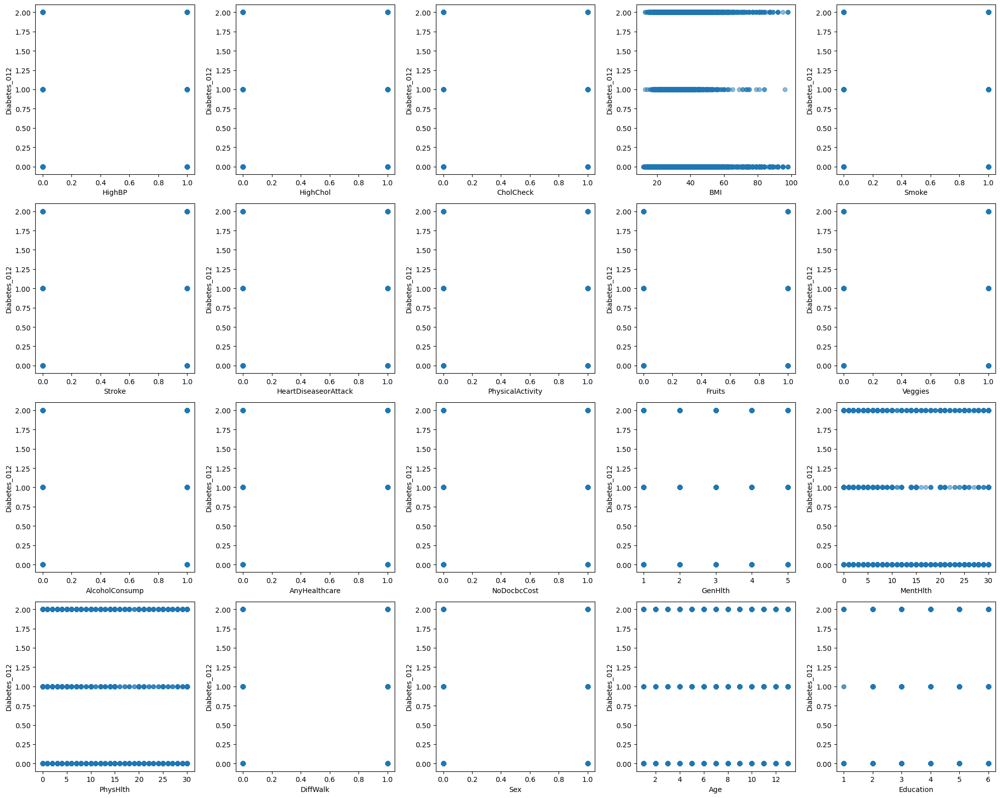

In [24]:
scatter_plot_with_diabetes(df)

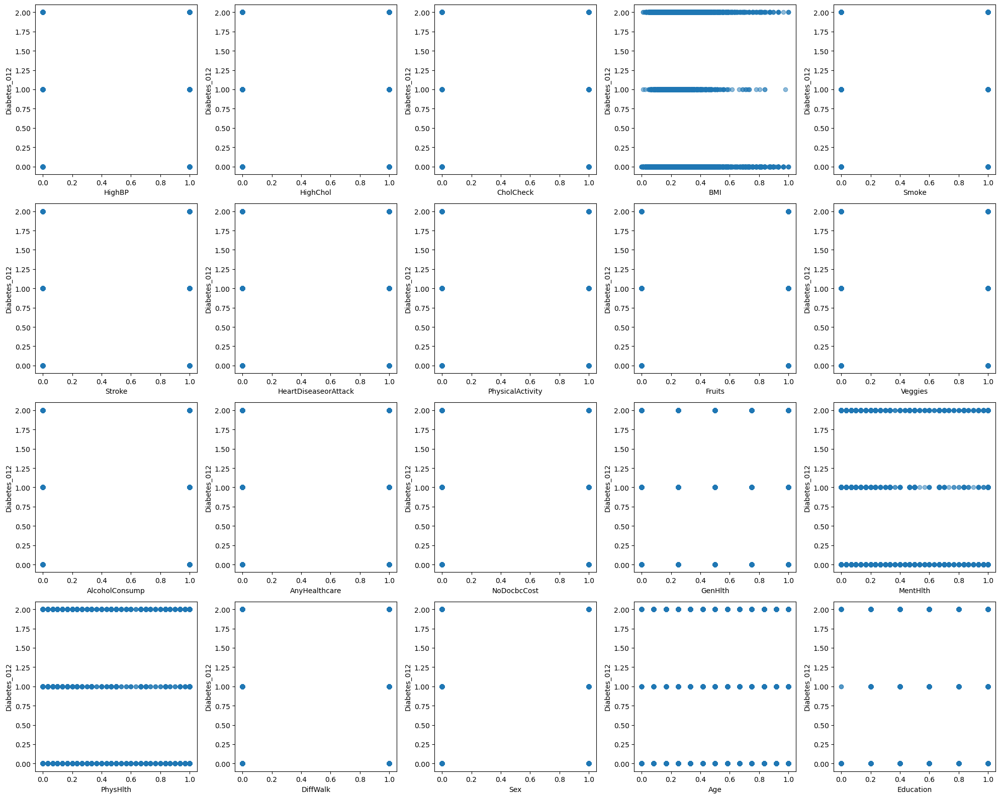

In [25]:
scatter_plot_with_diabetes(df_scaled)

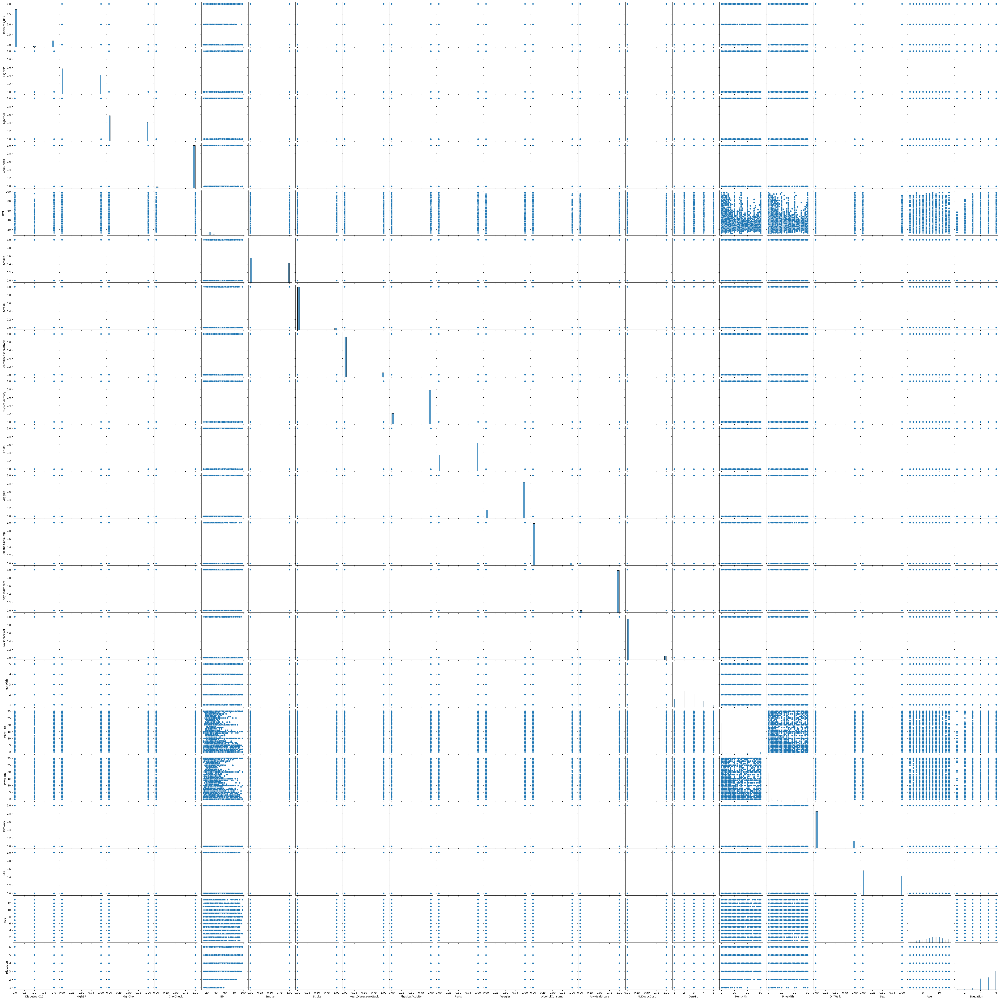

In [27]:
sns.pairplot(df)

In [7]:
df_corr = df.corr()
df_corr

,Diabetes_012,HighBP,HighChol,CholCheck,BMI,Smoke,Stroke,HeartDiseaseorAttack,PhysicalActivity,Fruits,...,AlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education
Diabetes_012,1.000000,0.271323,0.209294,0.067293,0.225294,0.064170,0.107494,0.179746,-0.120440,-0.041679,...,-0.057718,0.014635,0.035353,0.301277,0.073744,0.176018,0.223192,0.032195,0.184004,-0.128220
HighBP,0.271323,1.000000,0.298583,0.098488,0.213931,0.098372,0.130504,0.208919,-0.124890,-0.040013,...,-0.003313,0.037828,0.016703,0.299126,0.055280,0.160816,0.222913,0.053435,0.344470,-0.140434
HighChol,0.209294,0.298583,1.000000,0.086059,0.107228,0.092312,0.092927,0.181595,-0.077884,-0.040837,...,-0.010964,0.042047,0.012762,0.207800,0.061287,0.121551,0.143781,0.032029,0.272230,-0.069746
CholCheck,0.067293,0.098488,0.086059,1.000000,0.034688,-0.009377,0.024421,0.044278,0.005381,0.024418,...,-0.023727,0.117794,-0.059158,0.046013,-0.008767,0.031867,0.040418,-0.021741,0.090804,0.002417
BMI,0.225294,0.213931,0.107228,0.034688,1.000000,0.013567,0.020406,0.052858,-0.148409,-0.088325,...,-0.048858,-0.018967,0.058378,0.241492,0.086181,0.121240,0.197472,0.043287,-0.036464,-0.105728
Smoke,0.064170,0.098372,0.092312,-0.009377,0.013567,1.000000,0.061023,0.115837,-0.091409,-0.079937,...,0.101261,-0.023083,0.050209,0.167045,0.093083,0.118552,0.124813,0.091489,0.120442,-0.166025
Stroke,0.107494,0.130504,0.092927,0.024421,0.020406,0.061023,1.000000,0.203176,-0.070470,-0.013688,...,-0.017004,0.008568,0.035409,0.179772,0.070587,0.150152,0.178127,0.002812,0.127381,-0.077581
HeartDiseaseorAttack,0.179746,0.208919,0.181595,0.044278,0.052858,0.115837,0.203176,1.000000,-0.087356,-0.020080,...,-0.028933,0.018589,0.029840,0.258659,0.062842,0.181524,0.212186,0.087018,0.222275,-0.099139
PhysicalActivity,-0.120440,-0.124890,-0.077884,0.005381,-0.148409,-0.091409,-0.070470,-0.087356,1.000000,0.141601,...,0.011521,0.036558,-0.061284,-0.264286,-0.125515,-0.219510,-0.253056,0.030250,-0.093558,0.198497
Fruits,-0.041679,-0.040013,-0.040837,0.024418,-0.088325,-0.079937,-0.013688,-0.020080,0.141601,1.000000,...,-0.036000,0.032088,-0.044349,-0.102725,-0.068287,-0.045148,-0.048510,-0.092058,0.064544,0.109294


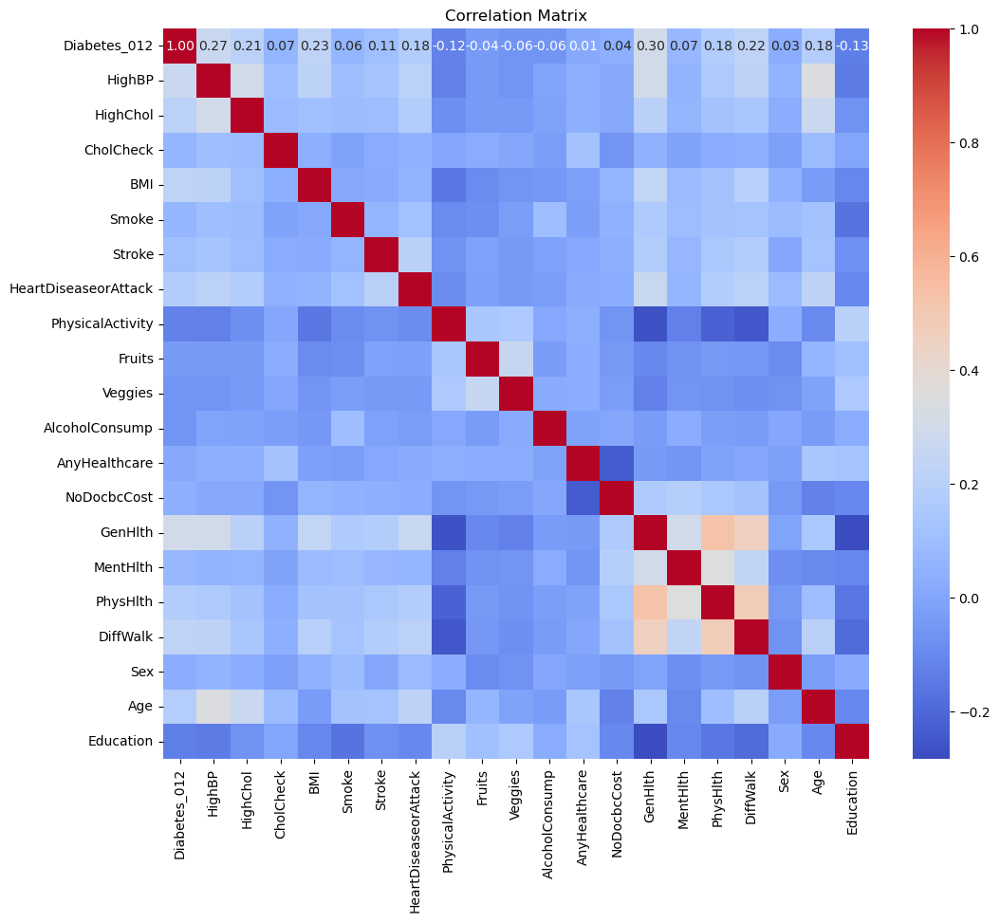

In [8]:
plt.figure(figsize=(12, 10))
sns.heatmap(df_corr, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix')
plt.show()

# PCA Without Scaling

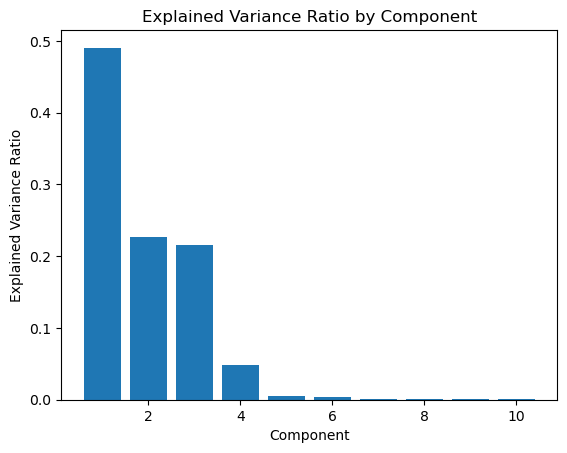

In [91]:
X = df.drop(columns=['Diabetes_012'])  # Features
y = df['Diabetes_012']  # Target

pca = PCA(n_components=10, random_state=1)
X_pca = pca.fit_transform(X)

explained_variance_ratio = pca.explained_variance_ratio_

plt.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio)
plt.xlabel('Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Component')
plt.show()

In [92]:
explained_variance_ratio

array([0.49064643, 0.22687361, 0.21540226, 0.04821509, 0.00565961,
       0.00347645, 0.00155066, 0.00125763, 0.00122569, 0.00114131])

In [93]:
X_pca.shape

(249998, 10)

In [94]:
df_pca = pd.DataFrame(X_pca, columns=["PC" + str(i+1) for i in range(X_pca.shape[1])])
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
0,18.937322,8.134214,7.104359,-1.720082,1.191750,-0.610210,-0.154962,-0.549328,0.055894,-0.660810
1,-5.744371,-2.389490,-0.452440,1.109543,0.045708,-1.121484,0.207272,-1.023363,0.110763,-0.731092
2,35.682946,-7.034723,8.328442,-1.319417,0.679252,-0.199254,-0.505143,0.195048,-0.755600,0.292670
3,-5.375329,-0.488890,-0.756954,-3.017166,1.394683,1.446450,-0.831740,0.226500,-0.115409,0.351433
4,-4.332469,-3.881010,1.570485,-3.155014,-0.164990,0.215972,-0.402846,0.692436,-0.624826,0.044591
...,...,...,...,...,...,...,...,...,...,...
249993,-5.696761,-2.411405,-0.677536,-0.996993,1.270388,-0.018889,-0.799901,0.374463,-0.270515,0.115598
249994,13.956720,-2.950818,3.702236,-0.294535,1.691646,-1.062084,-0.431105,0.797466,0.142094,-0.439062
249995,-6.193654,-5.318287,-0.753943,0.005500,2.354413,0.442130,-0.692524,0.065327,-0.368896,0.381165
249996,-3.937012,8.504653,0.494208,3.717950,1.044713,0.769995,0.637322,0.186285,0.301006,-0.060221


In [95]:
df_pca[['Diabetes_012']] = df[['Diabetes_012']]

In [96]:
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,Diabetes_012
0,18.937322,8.134214,7.104359,-1.720082,1.191750,-0.610210,-0.154962,-0.549328,0.055894,-0.660810,0
1,-5.744371,-2.389490,-0.452440,1.109543,0.045708,-1.121484,0.207272,-1.023363,0.110763,-0.731092,0
2,35.682946,-7.034723,8.328442,-1.319417,0.679252,-0.199254,-0.505143,0.195048,-0.755600,0.292670,0
3,-5.375329,-0.488890,-0.756954,-3.017166,1.394683,1.446450,-0.831740,0.226500,-0.115409,0.351433,0
4,-4.332469,-3.881010,1.570485,-3.155014,-0.164990,0.215972,-0.402846,0.692436,-0.624826,0.044591,0
...,...,...,...,...,...,...,...,...,...,...,...
249993,-5.696761,-2.411405,-0.677536,-0.996993,1.270388,-0.018889,-0.799901,0.374463,-0.270515,0.115598,0
249994,13.956720,-2.950818,3.702236,-0.294535,1.691646,-1.062084,-0.431105,0.797466,0.142094,-0.439062,1
249995,-6.193654,-5.318287,-0.753943,0.005500,2.354413,0.442130,-0.692524,0.065327,-0.368896,0.381165,2
249996,-3.937012,8.504653,0.494208,3.717950,1.044713,0.769995,0.637322,0.186285,0.301006,-0.060221,2


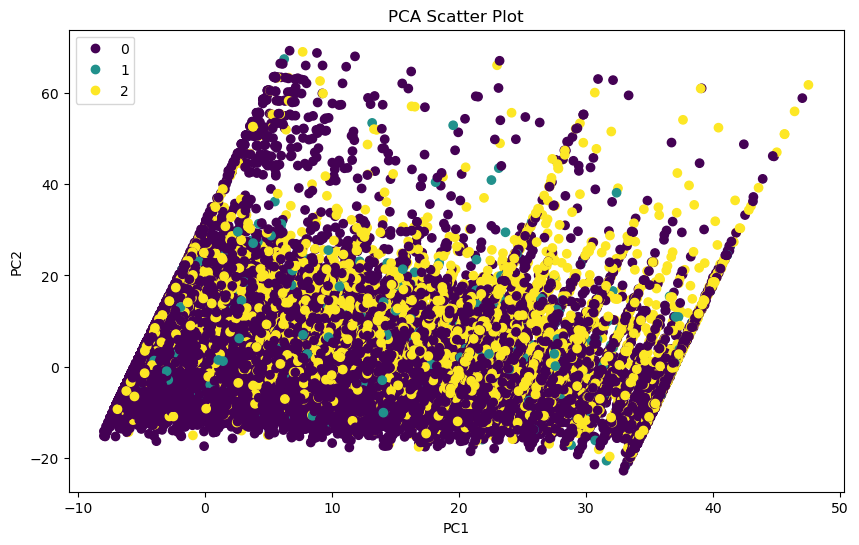

In [97]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC1'], df_pca['PC2'], c=df_pca['Diabetes_012'], cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
#plt.colorbar(scatter, label='Diabetes_012')
plt.show()

In [98]:
# Get the absolute loadings for each variable on each principal component
loadings = pd.DataFrame(pca.components_.T, columns=[f"PC{i + 1}" for i in range(X_pca.shape[1])], index=X.columns)

# Identify the top 3 contributing variables for each principal component
top_contributing_vars = {}
for pc in df_pca.columns:
    if pc != "Diabetes_012":
        sorted_vars = loadings[pc].abs().sort_values(ascending=False)
        top_contributing_vars[pc] = sorted_vars.index[:3].tolist()

# Print the top contributing variables for each principal component
for pc, vars_list in top_contributing_vars.items():
    print(f"Principal Component {pc}:")
    for rank, var in enumerate(vars_list, start=1):
        print(f"  {rank}. {var}")
    print()


Principal Component PC1:
  1. PhysHlth
  2. MentHlth
  3. BMI

Principal Component PC2:
  1. BMI
  2. MentHlth
  3. PhysHlth

Principal Component PC3:
  1. MentHlth
  2. PhysHlth
  3. Age

Principal Component PC4:
  1. Age
  2. MentHlth
  3. PhysHlth

Principal Component PC5:
  1. Education
  2. GenHlth
  3. Smoke

Principal Component PC6:
  1. GenHlth
  2. Education
  3. HighBP

Principal Component PC7:
  1. Sex
  2. Fruits
  3. Smoke

Principal Component PC8:
  1. HighChol
  2. Fruits
  3. HighBP

Principal Component PC9:
  1. Smoke
  2. HighChol
  3. Fruits

Principal Component PC10:
  1. Smoke
  2. Sex
  3. HighChol



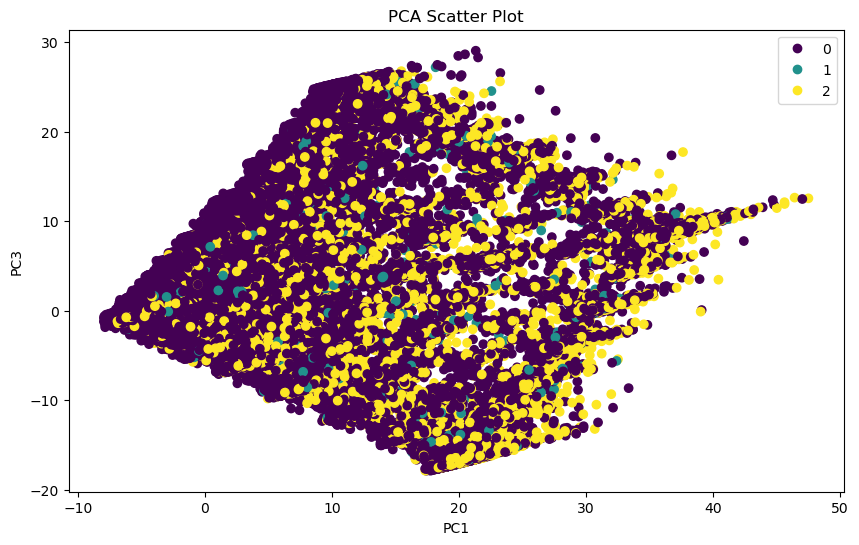

In [99]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC1'], df_pca['PC3'], c=df_pca['Diabetes_012'], cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC3')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
#plt.colorbar(scatter, label='Diabetes_012')
plt.show()

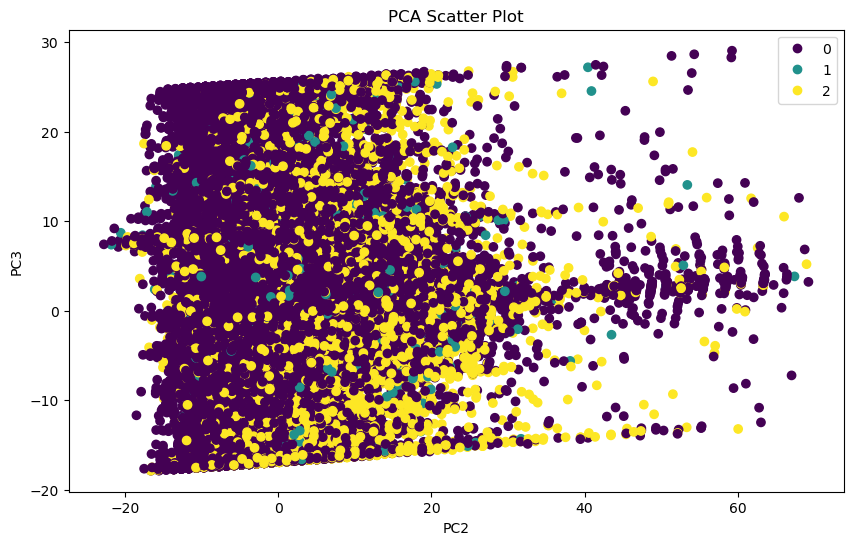

In [100]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC2'], df_pca['PC3'], c=df_pca['Diabetes_012'], cmap='viridis')
plt.xlabel('PC2')
plt.ylabel('PC3')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
#plt.colorbar(scatter, label='Diabetes_012')
plt.show()

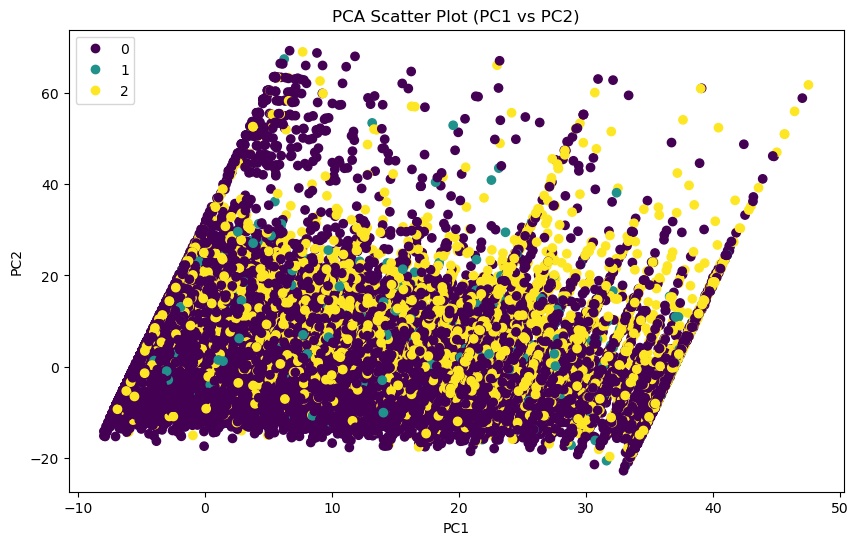

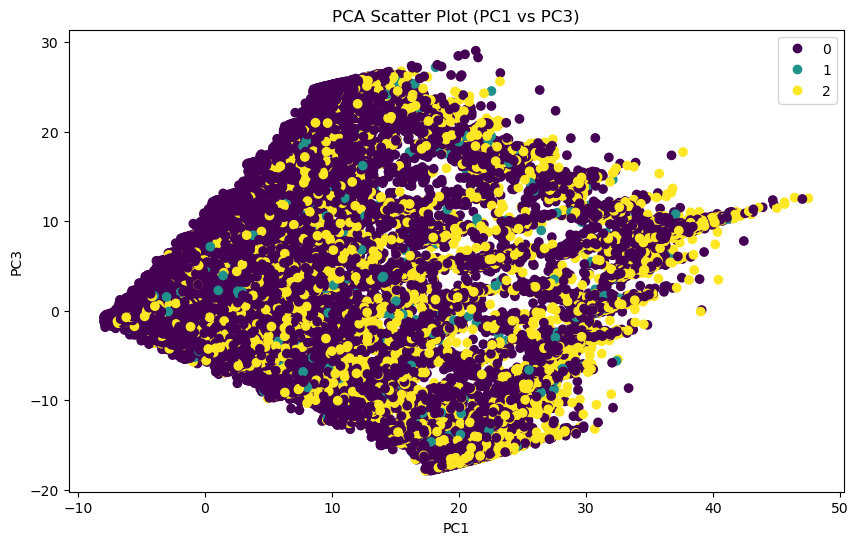

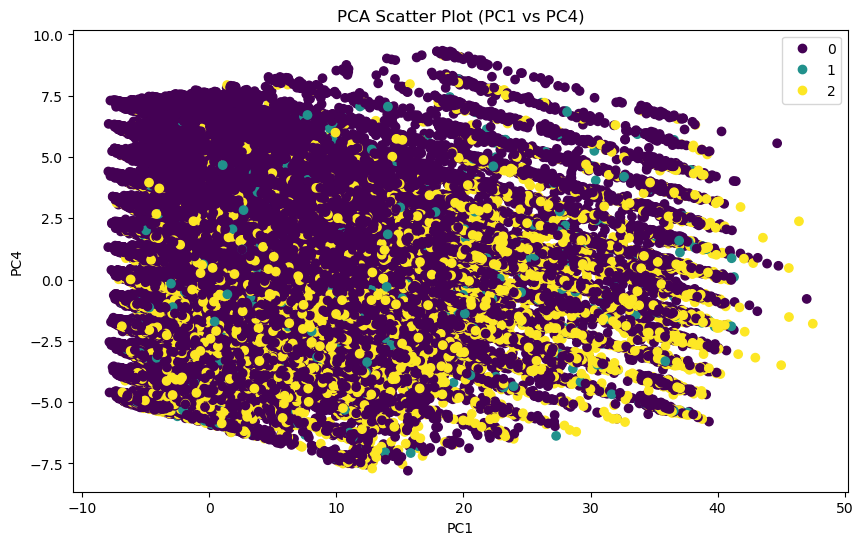

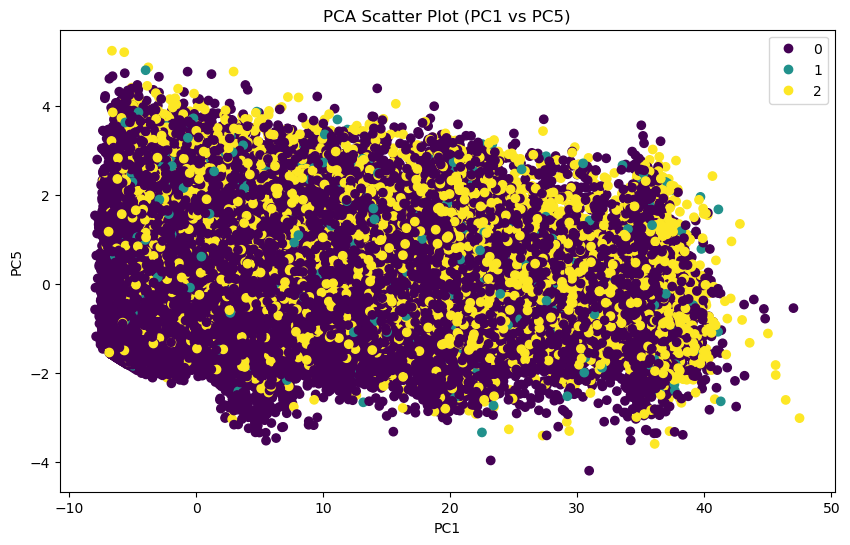

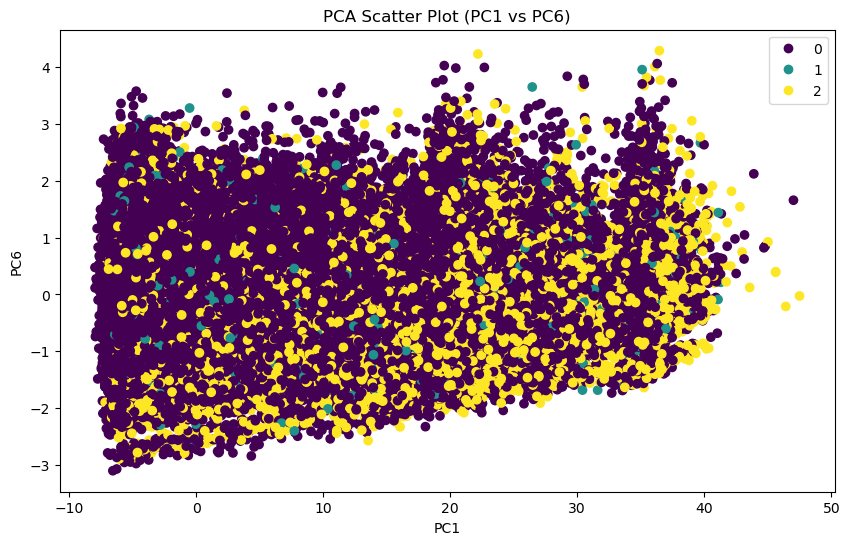

...

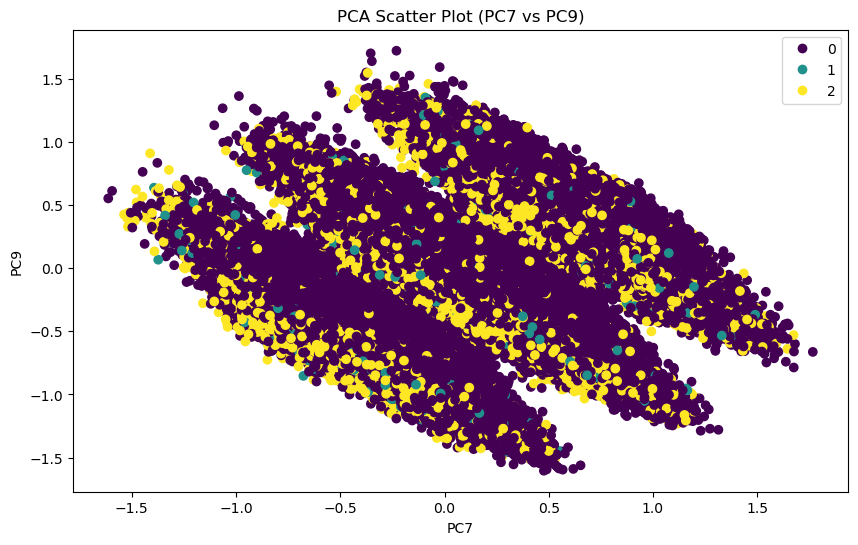

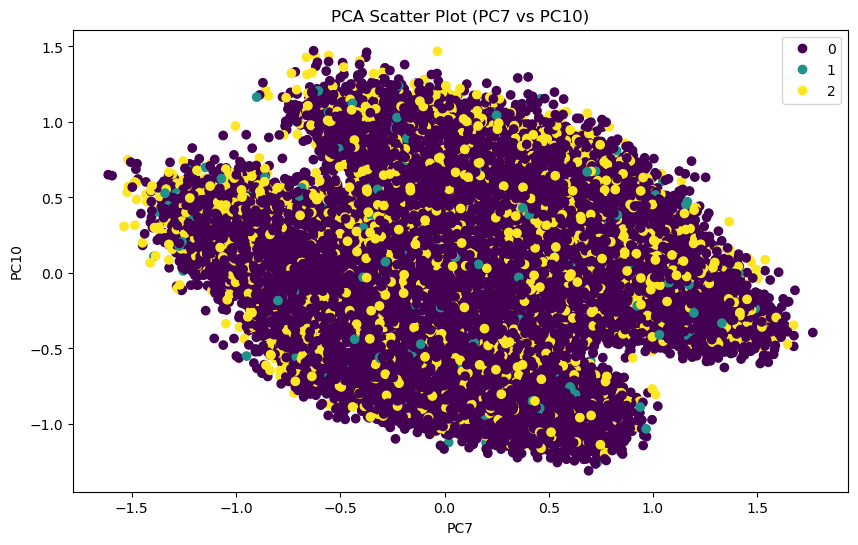

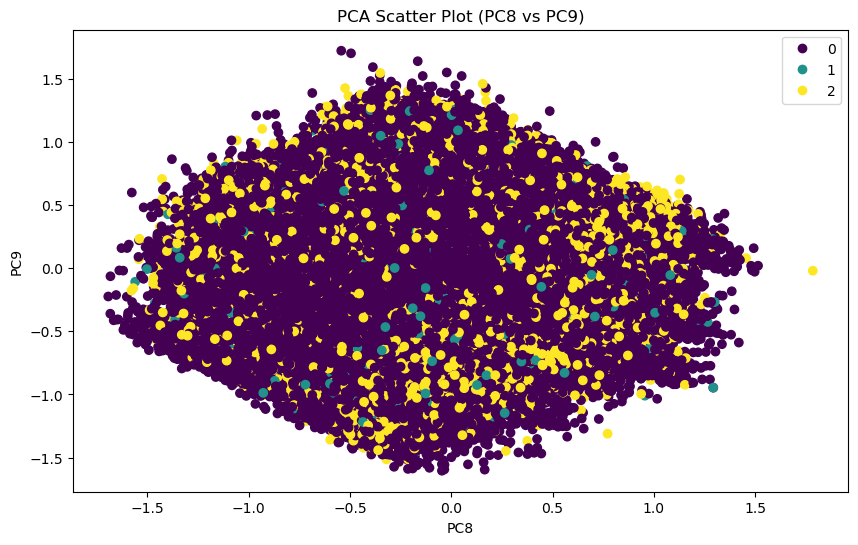

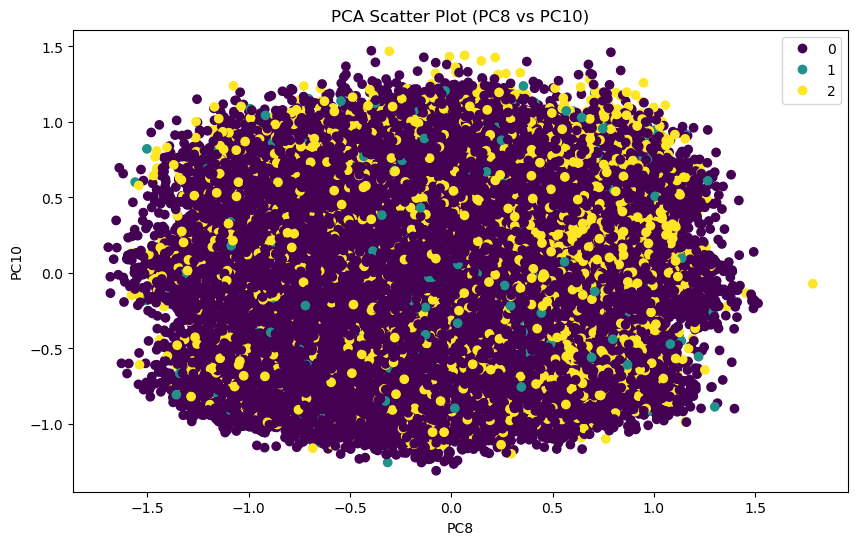

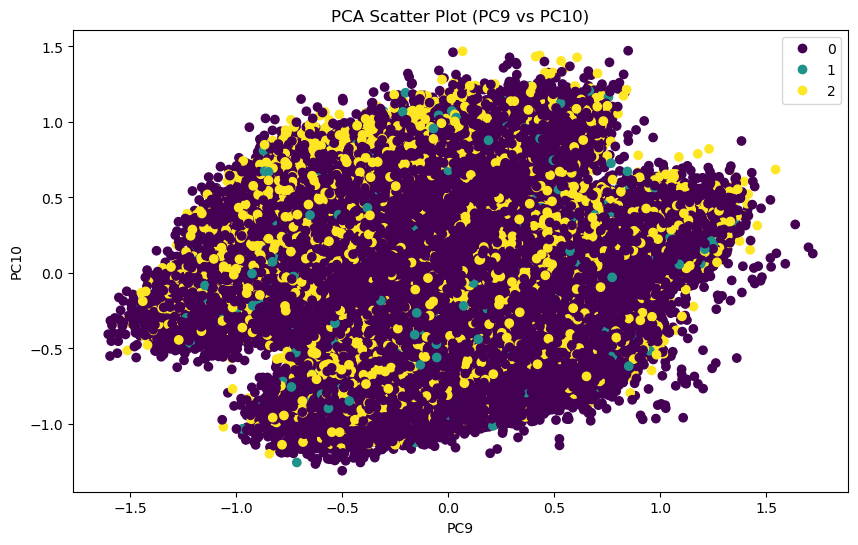

In [101]:
# Define the combinations of PC interactions
pc_combinations = list(itertools.combinations(df_pca.drop(columns=["Diabetes_012"]).columns, 2))

# Plot scatter plot for each combination of PC interactions
for pc1, pc2 in pc_combinations:
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(df_pca[pc1], df_pca[pc2], c=df_pca['Diabetes_012'], cmap='viridis')
    plt.xlabel(pc1)
    plt.ylabel(pc2)
    plt.title(f'PCA Scatter Plot ({pc1} vs {pc2})')
    plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
    plt.show()

# PCA With Scaling

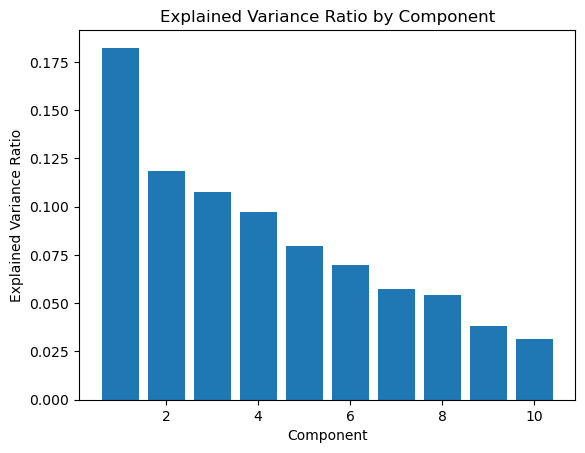

In [77]:
X = df_scaled.drop(columns=['Diabetes_012'])  # Features
y = df_scaled['Diabetes_012']  # Target

pca = PCA(n_components=10, random_state=1)
X_pca = pca.fit_transform(X)

explained_variance_ratio = pca.explained_variance_ratio_

plt.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio)
plt.xlabel('Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Component')
plt.show()

In [78]:
explained_variance_ratio

array([0.18230563, 0.11833744, 0.10776386, 0.09734038, 0.07974259,
       0.0699351 , 0.05720728, 0.05404583, 0.03811968, 0.03158777])

In [79]:
df_pca = pd.DataFrame(X_pca, columns=["PC" + str(i+1) for i in range(X_pca.shape[1])])
df_pca[['Diabetes_012']] = df[['Diabetes_012']]
df_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,Diabetes_012
0,1.001483,0.091437,1.056269,-0.378828,-0.299038,0.778417,0.300987,-0.472923,-0.089186,-0.324313,0
1,-0.177653,0.765326,0.882240,-0.298984,-0.495261,-0.275441,0.142847,0.661389,0.864070,0.397763,0
2,1.336533,-0.837308,0.890503,0.414264,0.705669,0.618783,0.246286,0.680953,0.875573,-0.180269,0
3,-0.320205,-0.681024,-0.051560,0.182470,0.276657,-0.717165,-0.132883,0.004808,-0.040400,0.011227,0
4,0.105476,-0.949409,-0.379456,0.408656,-0.306604,-0.231026,-0.150510,-0.009975,0.048027,-0.075856,0


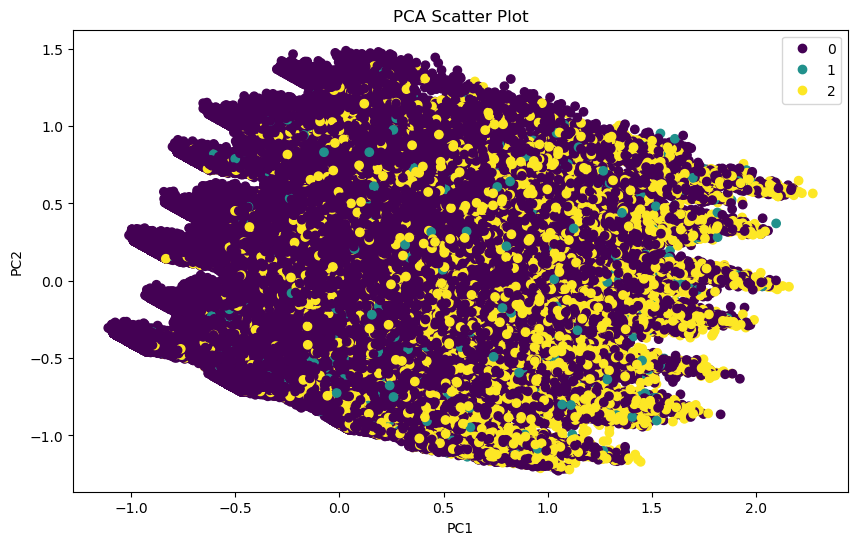

In [80]:
plt.figure(figsize=(10, 6))
scatter = plt.scatter(df_pca['PC1'], df_pca['PC2'], c=df_pca['Diabetes_012'], cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA Scatter Plot')
plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])
plt.show()

In [81]:
# Get the absolute loadings for each variable on each principal component
loadings = pd.DataFrame(pca.components_.T, columns=[f"PC{i + 1}" for i in range(X_pca.shape[1])], index=X.columns)

# Identify the top 3 contributing variables for each principal component
top_contributing_vars = {}
for pc in df_pca.columns:
    if pc != "Diabetes_012":
        sorted_vars = loadings[pc].abs().sort_values(ascending=False)
        top_contributing_vars[pc] = sorted_vars.index[:3].tolist()

# Print the top contributing variables for each principal component
for pc, vars_list in top_contributing_vars.items():
    print(f"Principal Component {pc}:")
    for rank, var in enumerate(vars_list, start=1):
        print(f"  {rank}. {var}")
    print()


Principal Component PC1:
  1. HighBP
  2. HighChol
  3. Smoke

Principal Component PC2:
  1. Sex
  2. Fruits
  3. Smoke

Principal Component PC3:
  1. Sex
  2. PhysicalActivity
  3. Fruits

Principal Component PC4:
  1. Smoke
  2. Fruits
  3. HighChol

Principal Component PC5:
  1. HighChol
  2. Sex
  3. Fruits

Principal Component PC6:
  1. HighBP
  2. HighChol
  3. PhysicalActivity

Principal Component PC7:
  1. PhysicalActivity
  2. DiffWalk
  3. PhysHlth

Principal Component PC8:
  1. Veggies
  2. PhysicalActivity
  3. Fruits

Principal Component PC9:
  1. NoDocbcCost
  2. Age
  3. AnyHealthcare

Principal Component PC10:
  1. HeartDiseaseorAttack
  2. DiffWalk
  3. NoDocbcCost



In [89]:
df_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,Diabetes_012
0,1.001483,0.091437,1.056269,-0.378828,-0.299038,0.778417,0.300987,-0.472923,-0.089186,-0.324313,0
1,-0.177653,0.765326,0.882240,-0.298984,-0.495261,-0.275441,0.142847,0.661389,0.864070,0.397763,0
2,1.336533,-0.837308,0.890503,0.414264,0.705669,0.618783,0.246286,0.680953,0.875573,-0.180269,0
3,-0.320205,-0.681024,-0.051560,0.182470,0.276657,-0.717165,-0.132883,0.004808,-0.040400,0.011227,0
4,0.105476,-0.949409,-0.379456,0.408656,-0.306604,-0.231026,-0.150510,-0.009975,0.048027,-0.075856,0
...,...,...,...,...,...,...,...,...,...,...,...
249993,-0.368956,-0.687944,-0.099674,0.210872,-0.487100,0.465538,0.029192,0.049112,-0.052238,0.008882,0
249994,1.068977,-0.800536,0.137890,-0.605494,-0.022890,0.025427,0.749231,0.157347,0.707192,-0.194161,1
249995,-0.152202,-0.414073,0.195493,0.394474,0.314041,-0.678052,-0.293814,0.887076,0.059502,-0.003297,2
249996,0.425800,0.574635,-0.113062,-0.292925,0.728807,-0.236631,-1.017655,0.526251,0.207203,-0.125861,2


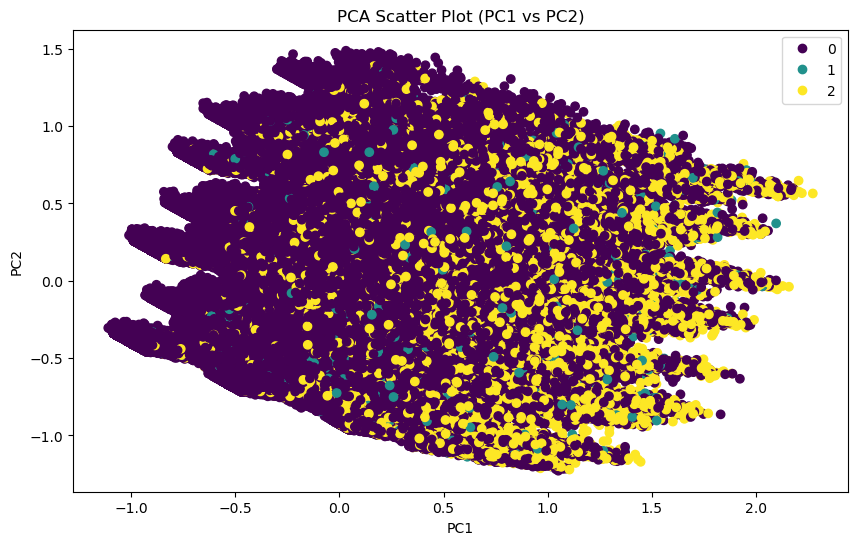

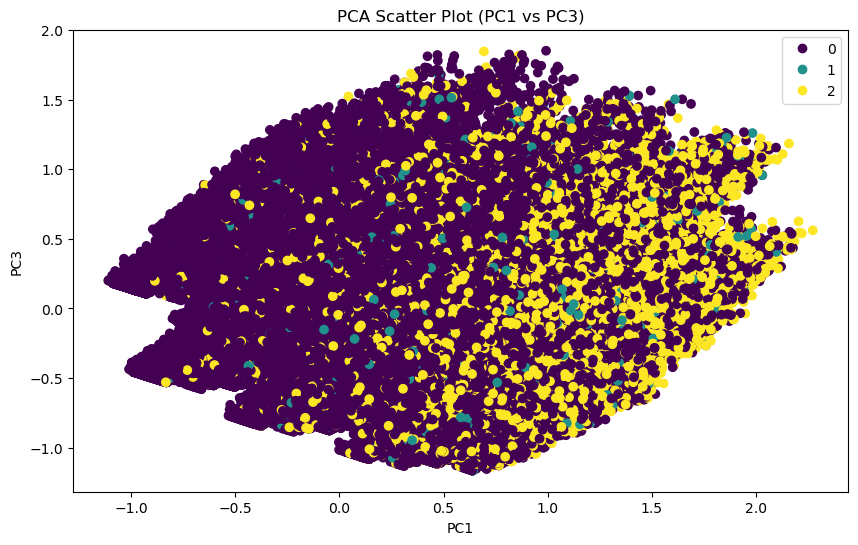

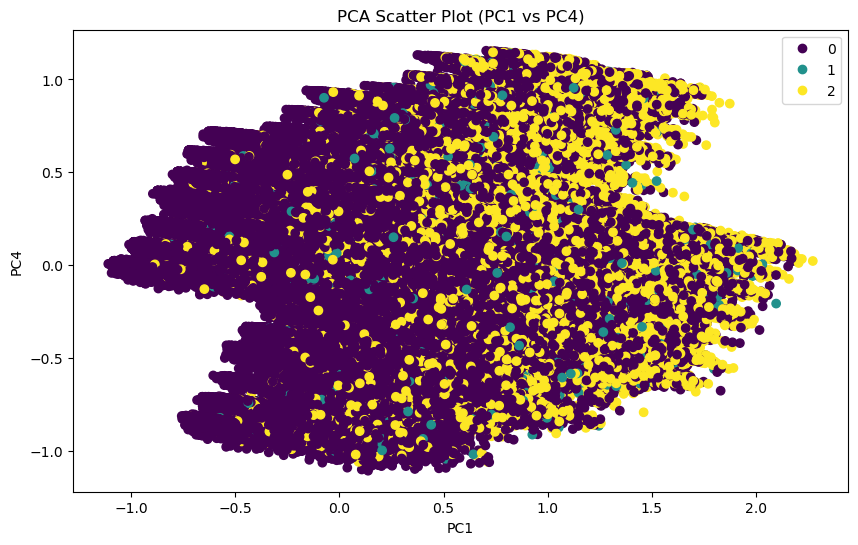

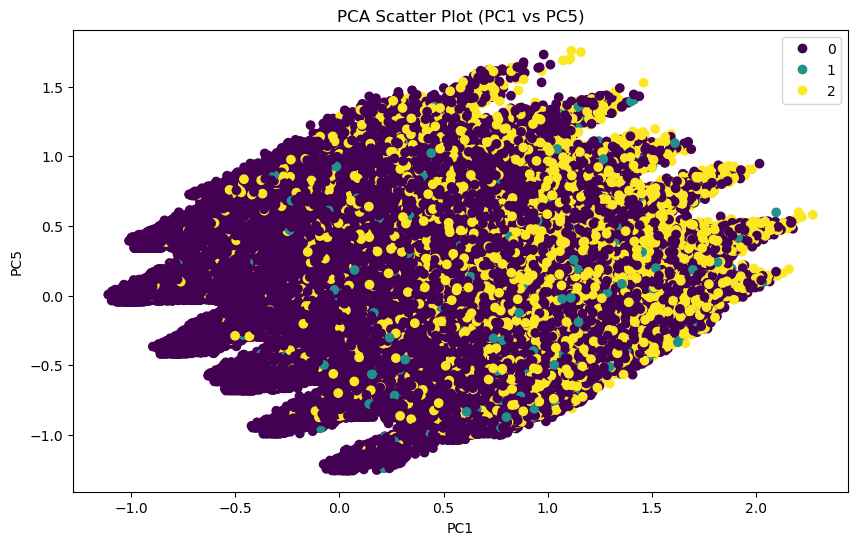

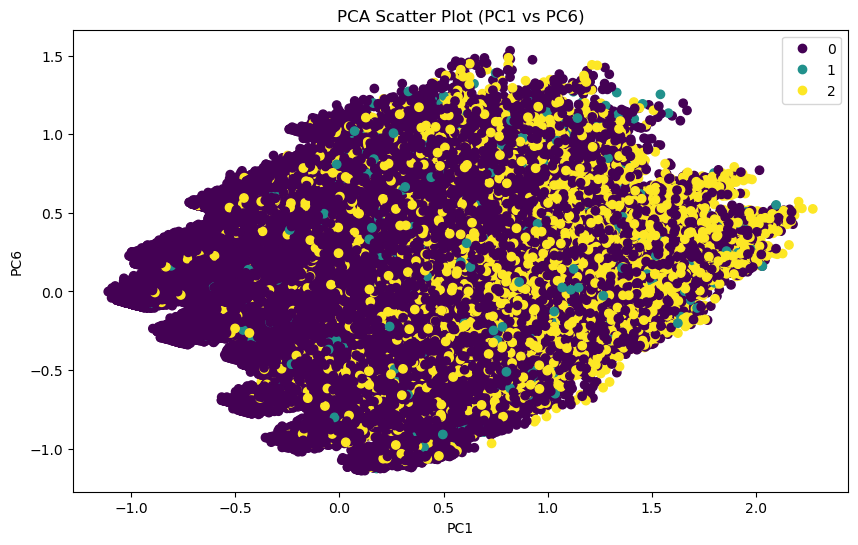

...

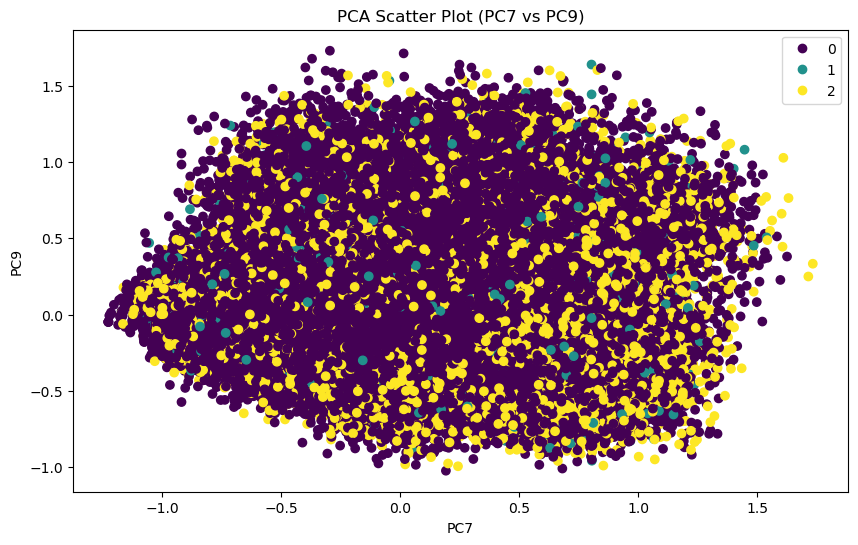

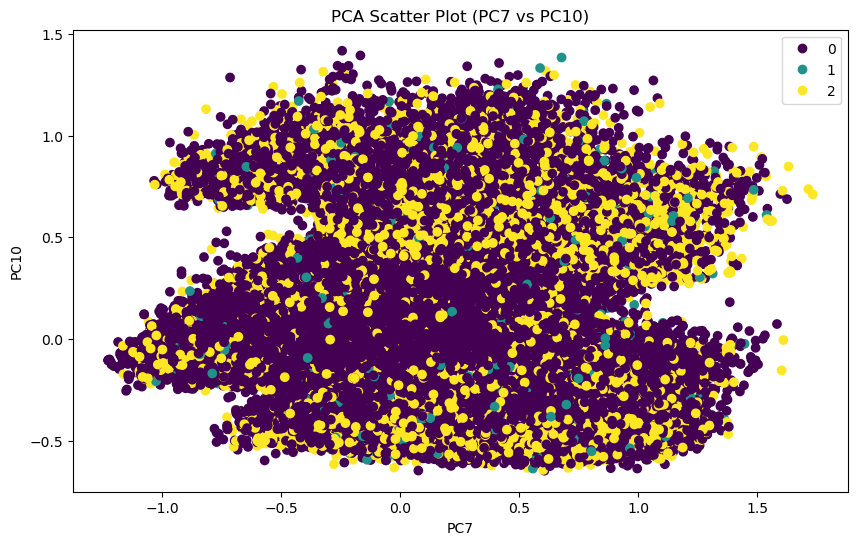

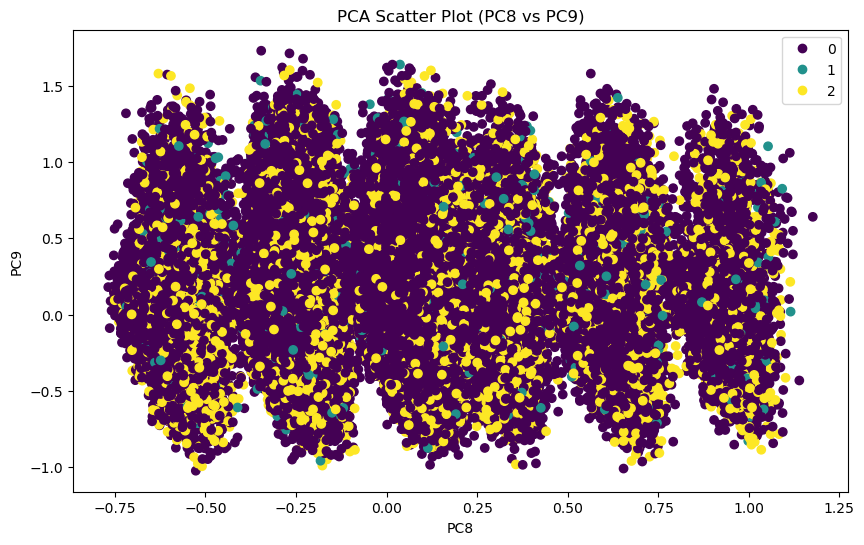

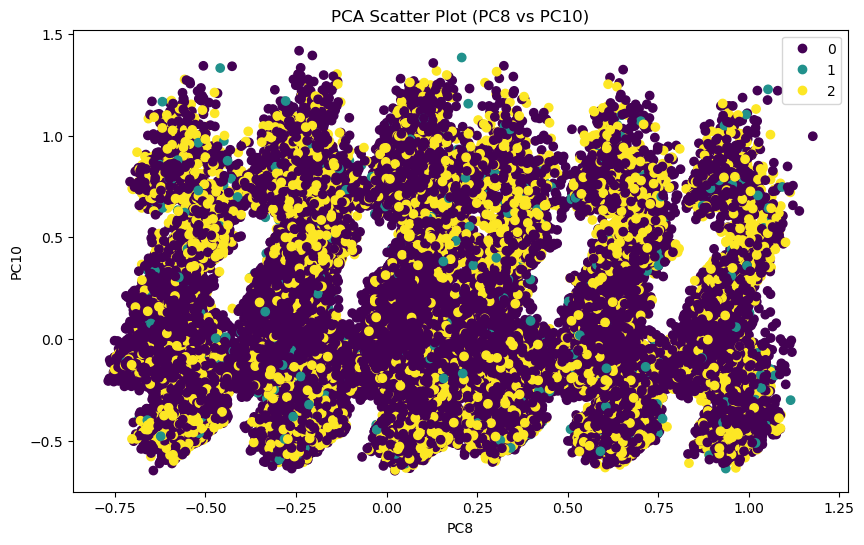

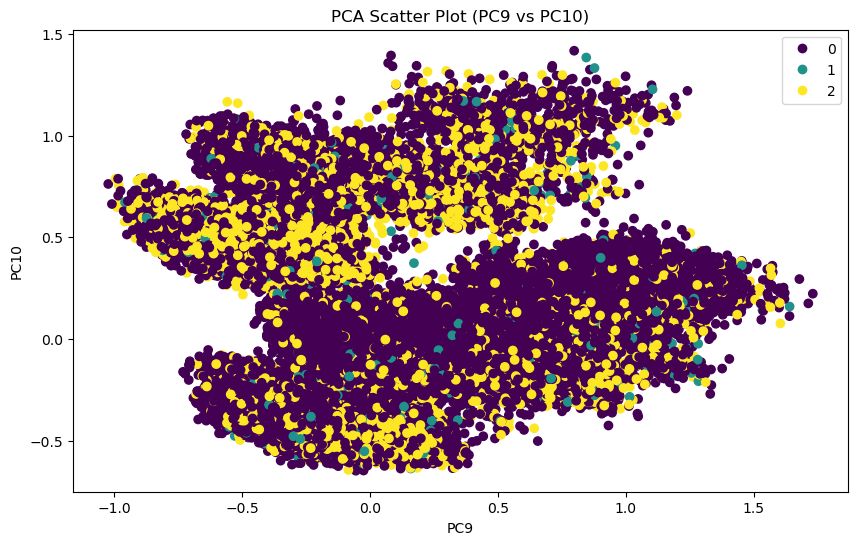

In [90]:
# Define the combinations of PC interactions
pc_combinations = list(itertools.combinations(df_pca.drop(columns=["Diabetes_012"]).columns, 2))

# Plot scatter plot for each combination of PC interactions
for pc1, pc2 in pc_combinations:
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(df_pca[pc1], df_pca[pc2], c=df_pca['Diabetes_012'], cmap='viridis')
    plt.xlabel(pc1)
    plt.ylabel(pc2)
    plt.title(f'PCA Scatter Plot ({pc1} vs {pc2})')
    plt.legend(handles=scatter.legend_elements()[0], labels=['0', '1', '2'])  # Add legend with class labels
    plt.show()